In [ ]:
'''# mount drive
from google.colab import drive
drive.mount('/content/drive')'''

In [ ]:
'''# move directory
import os
colab_dir = "./drive/MyDrive/"
os.chdir(colab_dir)'''

In [1]:
# import libraries
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib_inline
%matplotlib inline

In [2]:
# pip install
##  pandas profiling
!pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip    
from pandas_profiling import ProfileReport


[notice] A new release of pip is available: 24.0 -> 24.2
[notice] To update, run: C:\Users\evgen\AppData\Local\Programs\Python\Python39\python.exe -m pip install --upgrade pip


  Using cached https://github.com/pandas-profiling/pandas-profiling/archive/master.zip
  Installing build dependencies: started
  Installing build dependencies: finished with status 'done'
  Getting requirements to build wheel: started
  Getting requirements to build wheel: finished with status 'done'
  Preparing metadata (pyproject.toml): started
  Preparing metadata (pyproject.toml): finished with status 'done'


C:\Users\evgen\AppData\Local\Temp\ipykernel_12016\2741229815.py:4: DeprecationWarning: `import pandas_profiling` is going to be deprecated by April 1st. Please use `import ydata_profiling` instead.
  from pandas_profiling import ProfileReport


In [4]:
# set random seed
import random
random.seed(335)

In [5]:
# magic word
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)

In [6]:
# for better viz
import pprint
import warnings
warnings.filterwarnings('ignore')

### reference
-------------------

- [pandas cheat sheet](https://github.com/pandas-dev/pandas/tree/master/doc/cheatsheet)
- [numpy cheat sheet(data camp)](https://www.datacamp.com/community/blog/python-numpy-cheat-sheet)
- [scikit-learn cheat sheet(data camp)](datacamp.com/community/blog/scikit-learn-cheat-sheet)

# data understanding
------------
The data understanding phase starts with an initial data collection and proceeds withactivities in order to get familiar with the data, to identify data quality problems, to discover first insights into the data or to detect interesting subsets to form hypothesesfor hidden information.

## collect initial data
----------


In [7]:
# read csv file
df_flights = pd.read_csv('Data/ALL_FLIGHTS_2021_2023.csv')
df_airports = pd.read_csv('Data/airports.csv')

## describe data
----------

In [8]:
# number of records and fields
df_flights.shape # (records, fields)

(17269944, 32)

In [9]:
# head
df_flights.head(n=5)

,FL_DATE,AIRLINE,AIRLINE_DOT,AIRLINE_CODE,DOT_CODE,FL_NUMBER,ORIGIN,ORIGIN_CITY,DEST,DEST_CITY,CRS_DEP_TIME,DEP_TIME,DEP_DELAY,TAXI_OUT,WHEELS_OFF,WHEELS_ON,TAXI_IN,CRS_ARR_TIME,ARR_TIME,ARR_DELAY,CANCELLED,CANCELLATION_CODE,DIVERTED,CRS_ELAPSED_TIME,ELAPSED_TIME,AIR_TIME,DISTANCE,DELAY_DUE_CARRIER,DELAY_DUE_WEATHER,DELAY_DUE_NAS,DELAY_DUE_SECURITY,DELAY_DUE_LATE_AIRCRAFT
0,2021-01-01,Spirit Air Lines,Spirit Air Lines: NK,NK,20416,917,LGA,"New York, NY",DFW,"Dallas/Fort Worth, TX",1359,1356.0,-3.0,13.0,1409.0,1647.0,13.0,1655,1700.0,5.0,0.0,NaN,0.0,236.0,244.0,218.0,1389.0,NaN,NaN,NaN,NaN,NaN
1,2021-01-01,Envoy Air,Envoy Air: MQ,MQ,20398,4111,JAN,"Jackson/Vicksburg, MS",DFW,"Dallas/Fort Worth, TX",1221,1219.0,-2.0,8.0,1227.0,1341.0,15.0,1403,1356.0,-7.0,0.0,NaN,0.0,102.0,97.0,74.0,408.0,NaN,NaN,NaN,NaN,NaN
2,2021-01-01,Spirit Air Lines,Spirit Air Lines: NK,NK,20416,913,MCI,"Kansas City, MO",LAX,"Los Angeles, CA",1932,1931.0,-1.0,13.0,1944.0,2033.0,7.0,2103,2040.0,-23.0,0.0,NaN,0.0,211.0,189.0,169.0,1363.0,NaN,NaN,NaN,NaN,NaN
3,2021-01-01,American Airlines Inc.,American Airlines Inc.: AA,AA,19805,474,PHX,"Phoenix, AZ",PHL,"Philadelphia, PA",1320,1312.0,-8.0,14.0,1326.0,1925.0,6.0,1941,1931.0,-10.0,0.0,NaN,0.0,261.0,259.0,239.0,2075.0,NaN,NaN,NaN,NaN,NaN
4,2021-01-01,PSA Airlines Inc.,PSA Airlines Inc.: OH,OH,20397,5629,OMA,"Omaha, NE",CLT,"Charlotte, NC",626,623.0,-3.0,29.0,652.0,1017.0,4.0,1022,1021.0,-1.0,0.0,NaN,0.0,176.0,178.0,145.0,913.0,NaN,NaN,NaN,NaN,NaN


In [10]:
# tail
df_flights.tail(n=5)

,FL_DATE,AIRLINE,AIRLINE_DOT,AIRLINE_CODE,DOT_CODE,FL_NUMBER,ORIGIN,ORIGIN_CITY,DEST,DEST_CITY,CRS_DEP_TIME,DEP_TIME,DEP_DELAY,TAXI_OUT,WHEELS_OFF,WHEELS_ON,TAXI_IN,CRS_ARR_TIME,ARR_TIME,ARR_DELAY,CANCELLED,CANCELLATION_CODE,DIVERTED,CRS_ELAPSED_TIME,ELAPSED_TIME,AIR_TIME,DISTANCE,DELAY_DUE_CARRIER,DELAY_DUE_WEATHER,DELAY_DUE_NAS,DELAY_DUE_SECURITY,DELAY_DUE_LATE_AIRCRAFT
17269939,2023-08-31,Southwest Airlines Co.,Southwest Airlines Co.: WN,WN,19393,3068,DAL,"Dallas, TX",SAT,"San Antonio, TX",2150,2205.0,15.0,7.0,2212.0,2252.0,3.0,2250,2255.0,5.0,0.0,NaN,0.0,60.0,50.0,40.0,247.0,NaN,NaN,NaN,NaN,NaN
17269940,2023-08-31,Southwest Airlines Co.,Southwest Airlines Co.: WN,WN,19393,4795,DAL,"Dallas, TX",LAX,"Los Angeles, CA",1450,1514.0,24.0,15.0,1529.0,1615.0,10.0,1600,1625.0,25.0,0.0,NaN,0.0,190.0,191.0,166.0,1246.0,4.0,0.0,1.0,0.0,20.0
17269941,2023-08-31,Southwest Airlines Co.,Southwest Airlines Co.: WN,WN,19393,5171,DAL,"Dallas, TX",MCO,"Orlando, FL",2045,2047.0,2.0,8.0,2055.0,7.0,6.0,20,13.0,-7.0,0.0,NaN,0.0,155.0,146.0,132.0,973.0,NaN,NaN,NaN,NaN,NaN
17269942,2023-08-31,Southwest Airlines Co.,Southwest Airlines Co.: WN,WN,19393,1902,DCA,"Washington, DC",MCO,"Orlando, FL",1400,1400.0,0.0,12.0,1412.0,1650.0,7.0,1620,1657.0,37.0,0.0,NaN,0.0,140.0,177.0,158.0,759.0,0.0,0.0,37.0,0.0,0.0
17269943,2023-08-31,Spirit Air Lines,Spirit Air Lines: NK,NK,20416,913,MCI,"Kansas City, MO",LAX,"Los Angeles, CA",2027,2020.0,-7.0,12.0,2032.0,2130.0,11.0,2150,2141.0,-9.0,0.0,NaN,0.0,203.0,201.0,178.0,1363.0,NaN,NaN,NaN,NaN,NaN


In [11]:
# data types
df_flights.dtypes

FL_DATE                     object
AIRLINE                     object
AIRLINE_DOT                 object
AIRLINE_CODE                object
DOT_CODE                     int64
FL_NUMBER                    int64
ORIGIN                      object
ORIGIN_CITY                 object
DEST                        object
DEST_CITY                   object
CRS_DEP_TIME                 int64
DEP_TIME                   float64
DEP_DELAY                  float64
TAXI_OUT                   float64
WHEELS_OFF                 float64
WHEELS_ON                  float64
TAXI_IN                    float64
CRS_ARR_TIME                 int64
ARR_TIME                   float64
ARR_DELAY                  float64
CANCELLED                  float64
CANCELLATION_CODE           object
DIVERTED                   float64
CRS_ELAPSED_TIME           float64
ELAPSED_TIME               float64
AIR_TIME                   float64
DISTANCE                   float64
DELAY_DUE_CARRIER          float64
DELAY_DUE_WEATHER   

Too huge dataset to comfort work with. However, I will use only Soutwest airlines (our company) data, exclude Data Understanding stage: here full dataset will be used to compare our company with others.
Also we can see very fun time format: "xyvw" or "yvw" as float or integer. It means xy:vw or y:vw, not amount of minutes from 00:00 of this day. 

In [12]:
df_airports.shape # (records, fields)

(341, 7)

In [13]:
df_airports.head(5)

,IATA,AIRPORT,CITY,STATE,COUNTRY,LATITUDE,LONGITUDE
0,ABQ,Albuquerque International,Albuquerque,NM,USA,35.040222,-106.609194
1,ANC,Ted Stevens Anchorage International,Anchorage,AK,USA,61.174320,-149.996186
2,ATL,William B Hartsfield-Atlanta Intl,Atlanta,GA,USA,33.640444,-84.426944
3,AUS,Austin-Bergstrom International,Austin,TX,USA,30.194533,-97.669872
4,BDL,Bradley International,Windsor Locks,CT,USA,41.938874,-72.683228


In [14]:
df_airports.tail(5)

,IATA,AIRPORT,CITY,STATE,COUNTRY,LATITUDE,LONGITUDE
336,WRG,Wrangell,Wrangell,AK,USA,56.484326,-132.369824
337,WYS,Yellowstone,West Yellowstone,MT,USA,44.688399,-111.117638
338,XNA,Northwest Arkansas Regional,Fayetteville Springdale Rogers,AR,USA,36.281869,-94.306811
339,YAK,Yakutat,Yakutat,AK,USA,59.503361,-139.660226
340,YUM,Yuma MCAS-Yuma International,Yuma,AZ,USA,32.656583,-114.605972


In [15]:
df_airports.dtypes

IATA          object
AIRPORT       object
CITY          object
STATE         object
COUNTRY       object
LATITUDE     float64
LONGITUDE    float64
dtype: object

So, from this dataframe I want to have only IATA code of airport, latitude and longitude: all other information in flights dataset.

## explore data
----------


In [23]:
def convert_to_time_format(value):
  # Convert the value to a string
  if pd.isnull(value):
    value = -1
  value_str = str(int(value))

  # Ensure the string has at least 4 characters by padding with leading zeros if necessary
  value_str = value_str.zfill(4)

  # Extract hours and minutes
  hours = value_str[:-2]
  minutes = value_str[-2:]

  # Format as time
  return f"{hours}:{minutes}"

df_flights[["CRS_DEP_TIME", 'DEP_TIME', 'WHEELS_OFF', 'WHEELS_ON', 'CRS_ARR_TIME', 'ARR_TIME']] = df_flights[["CRS_DEP_TIME", 'DEP_TIME', 'WHEELS_OFF', 'WHEELS_ON', 'CRS_ARR_TIME', 'ARR_TIME']].applymap(convert_to_time_format)

"df_flights.shipping_date = pd.to_datetime(df.shipping_date, format='%Y/%m/%d')\ndf.price = df.price.astype('int64')\ndf.quantity = df.quantity.astype('int64')"

In [24]:
df_flights.head()

,FL_DATE,AIRLINE,AIRLINE_DOT,AIRLINE_CODE,DOT_CODE,FL_NUMBER,ORIGIN,ORIGIN_CITY,DEST,DEST_CITY,CRS_DEP_TIME,DEP_TIME,DEP_DELAY,TAXI_OUT,WHEELS_OFF,WHEELS_ON,TAXI_IN,CRS_ARR_TIME,ARR_TIME,ARR_DELAY,CANCELLED,CANCELLATION_CODE,DIVERTED,CRS_ELAPSED_TIME,ELAPSED_TIME,AIR_TIME,DISTANCE,DELAY_DUE_CARRIER,DELAY_DUE_WEATHER,DELAY_DUE_NAS,DELAY_DUE_SECURITY,DELAY_DUE_LATE_AIRCRAFT
0,2021-01-01,Spirit Air Lines,Spirit Air Lines: NK,NK,20416,917,LGA,"New York, NY",DFW,"Dallas/Fort Worth, TX",13:59,13:56,-3.0,13.0,14:09,16:47,13.0,16:55,17:00,5.0,0.0,NaN,0.0,236.0,244.0,218.0,1389.0,NaN,NaN,NaN,NaN,NaN
1,2021-01-01,Envoy Air,Envoy Air: MQ,MQ,20398,4111,JAN,"Jackson/Vicksburg, MS",DFW,"Dallas/Fort Worth, TX",12:21,12:19,-2.0,8.0,12:27,13:41,15.0,14:03,13:56,-7.0,0.0,NaN,0.0,102.0,97.0,74.0,408.0,NaN,NaN,NaN,NaN,NaN
2,2021-01-01,Spirit Air Lines,Spirit Air Lines: NK,NK,20416,913,MCI,"Kansas City, MO",LAX,"Los Angeles, CA",19:32,19:31,-1.0,13.0,19:44,20:33,7.0,21:03,20:40,-23.0,0.0,NaN,0.0,211.0,189.0,169.0,1363.0,NaN,NaN,NaN,NaN,NaN
3,2021-01-01,American Airlines Inc.,American Airlines Inc.: AA,AA,19805,474,PHX,"Phoenix, AZ",PHL,"Philadelphia, PA",13:20,13:12,-8.0,14.0,13:26,19:25,6.0,19:41,19:31,-10.0,0.0,NaN,0.0,261.0,259.0,239.0,2075.0,NaN,NaN,NaN,NaN,NaN
4,2021-01-01,PSA Airlines Inc.,PSA Airlines Inc.: OH,OH,20397,5629,OMA,"Omaha, NE",CLT,"Charlotte, NC",06:26,06:23,-3.0,29.0,06:52,10:17,4.0,10:22,10:21,-1.0,0.0,NaN,0.0,176.0,178.0,145.0,913.0,NaN,NaN,NaN,NaN,NaN


In [20]:
df_flights.columns

Index(['FL_DATE', 'AIRLINE', 'AIRLINE_DOT', 'AIRLINE_CODE', 'DOT_CODE',
       'FL_NUMBER', 'ORIGIN', 'ORIGIN_CITY', 'DEST', 'DEST_CITY',
       'CRS_DEP_TIME', 'DEP_TIME', 'DEP_DELAY', 'TAXI_OUT', 'WHEELS_OFF',
       'WHEELS_ON', 'TAXI_IN', 'CRS_ARR_TIME', 'ARR_TIME', 'ARR_DELAY',
       'CANCELLED', 'CANCELLATION_CODE', 'DIVERTED', 'CRS_ELAPSED_TIME',
       'ELAPSED_TIME', 'AIR_TIME', 'DISTANCE', 'DELAY_DUE_CARRIER',
       'DELAY_DUE_WEATHER', 'DELAY_DUE_NAS', 'DELAY_DUE_SECURITY',
       'DELAY_DUE_LATE_AIRCRAFT'],
      dtype='object')

In [25]:
df_flights['FL_DATE'] = pd.to_datetime(df_flights['FL_DATE'])

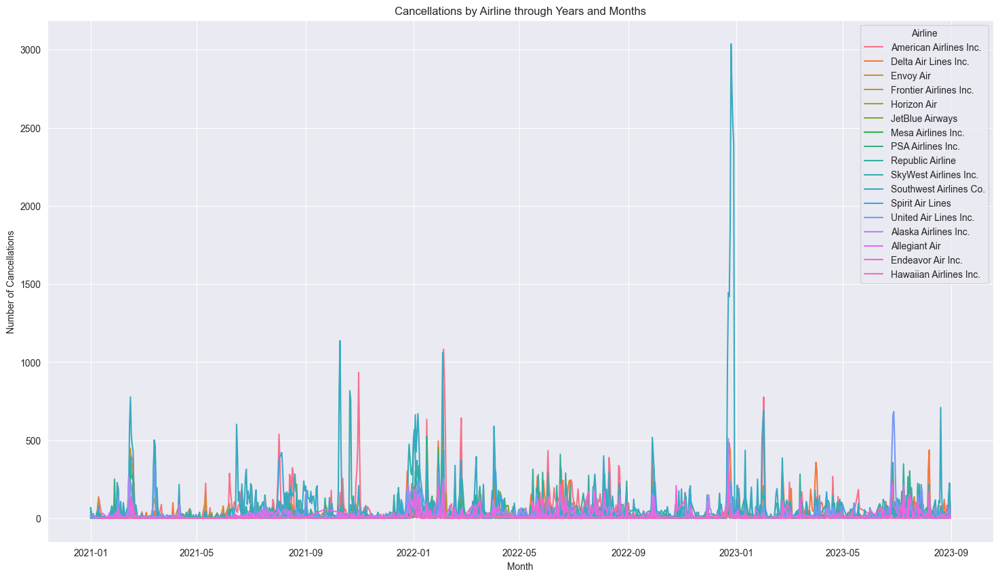

In [29]:
# 1. Plot of cancellations for different airlines through years and months
cancellation_df = df_flights[df_flights['CANCELLED'] == 1]
cancellation_counts = cancellation_df.groupby(['FL_DATE', 'AIRLINE']).size().reset_index(name='CANCELLATION_COUNT')

plt.figure(figsize=(18, 10))
sns.lineplot(data=cancellation_counts, x='FL_DATE', y='CANCELLATION_COUNT', hue='AIRLINE', markers=True)
plt.title('Cancellations by Airline through Years and Months')
plt.xlabel('Month')
plt.ylabel('Number of Cancellations')
plt.legend(title='Airline')
plt.show()

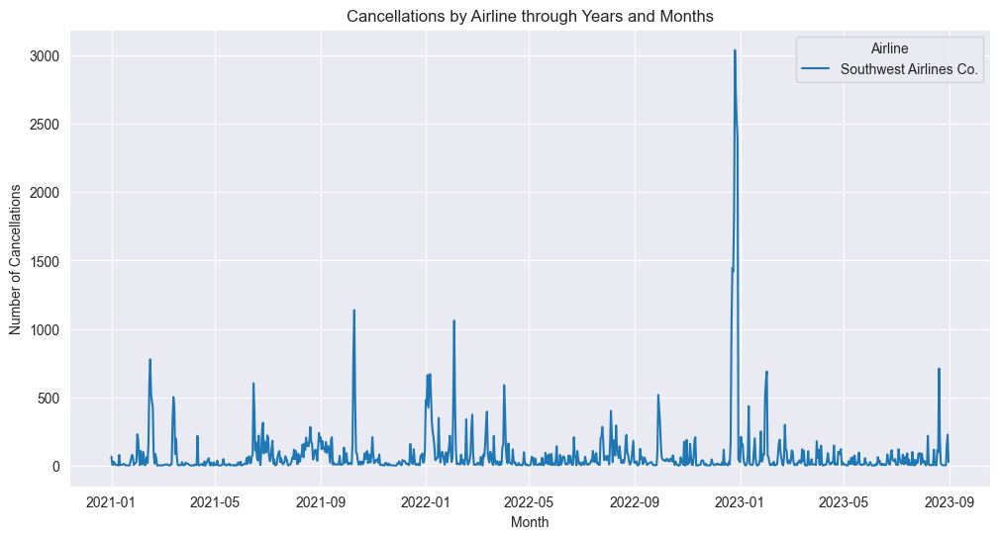

In [31]:
# 1. Plot of cancellations for different airlines through years and months
southwest_cancellation_df = df_flights.loc[(df_flights['CANCELLED'] == 1) & (df_flights['AIRLINE'] == 'Southwest Airlines Co.')]
cancellation_counts = southwest_cancellation_df.groupby(['FL_DATE', 'AIRLINE']).size().reset_index(name='CANCELLATION_COUNT')

plt.figure(figsize=(12, 6))
sns.lineplot(data=cancellation_counts, x='FL_DATE', y='CANCELLATION_COUNT', hue='AIRLINE', markers=True)
plt.title('Cancellations by Airline through Years and Months')
plt.xlabel('Month')
plt.ylabel('Number of Cancellations')
plt.legend(title='Airline')
plt.show()

We can easily saw difference between Southwest airlines and other companies...

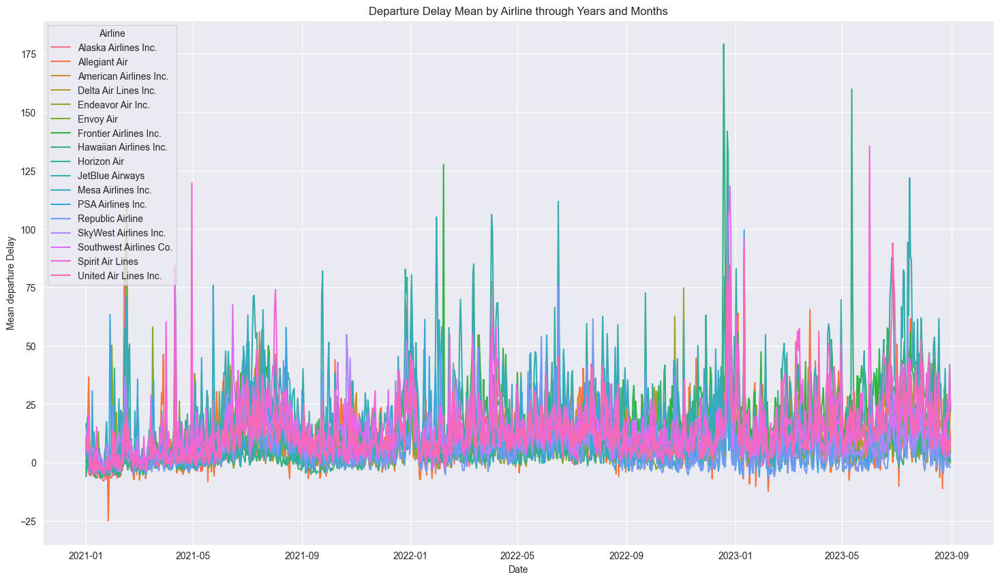

In [47]:
df_flights['FL_DATE'] = pd.to_datetime(df_flights['FL_DATE'])

# 2. Plot of DEP_DELAY's mean for different airlines through years and months
delay_stats = df_flights.groupby(['FL_DATE', 'AIRLINE']).agg({'DEP_DELAY': ['mean']}).reset_index()
delay_stats.columns = ['FL_DATE', 'AIRLINE', 'DEP_DELAY_MEAN']

plt.figure(figsize=(18, 10))
sns.lineplot(data=delay_stats, x='FL_DATE', y='DEP_DELAY_MEAN', hue='AIRLINE', markers=True)
plt.title('Departure Delay Mean by Airline through Years and Months')
plt.xlabel('Date')
plt.ylabel('Mean departure Delay')
plt.legend(title='Airline')
plt.show()

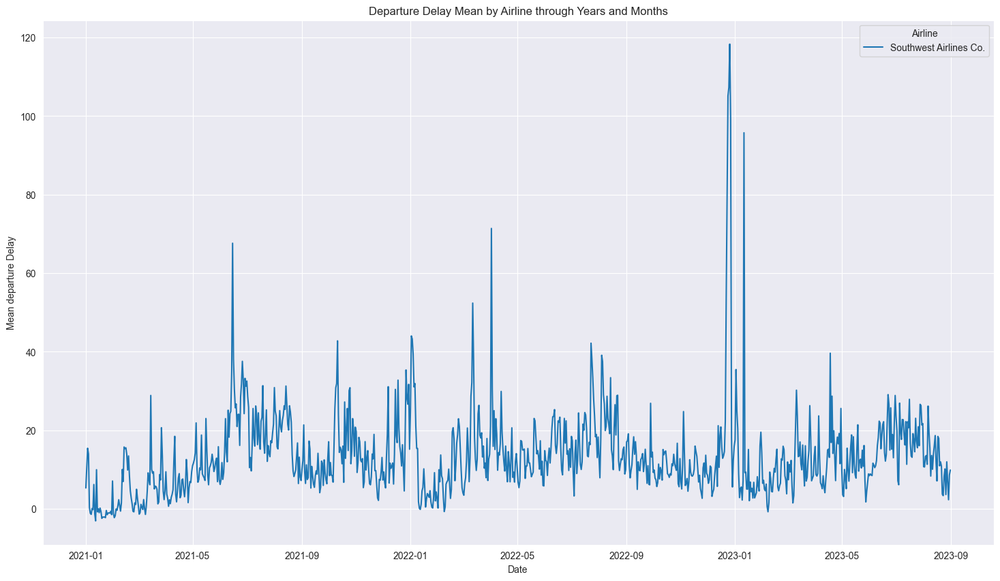

In [50]:
df_flights['FL_DATE'] = pd.to_datetime(df_flights['FL_DATE'])

# 2. Plot of DEP_DELAY's mean for different airlines through years and months
df_flights_southwest = df_flights.loc[df_flights['AIRLINE']=='Southwest Airlines Co.']
delay_stats = df_flights_southwest.groupby(['FL_DATE', 'AIRLINE']).agg({'DEP_DELAY': ['mean']}).reset_index()
delay_stats.columns = ['FL_DATE', 'AIRLINE', 'DEP_DELAY_MEAN']

plt.figure(figsize=(18, 10))
sns.lineplot(data=delay_stats, x='FL_DATE', y='DEP_DELAY_MEAN', hue='AIRLINE', markers=True)
plt.title('Departure Delay Mean by Airline through Years and Months')
plt.xlabel('Date')
plt.ylabel('Mean departure Delay')
plt.legend(title='Airline')
plt.show()

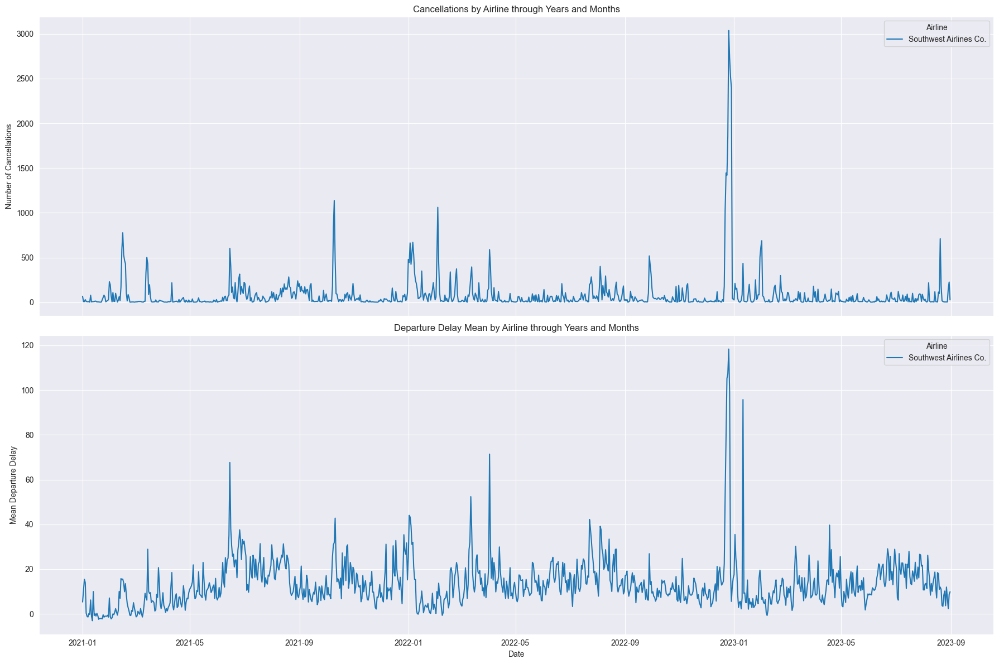

In [51]:
# Parse FL_DATE to datetime
df_flights['FL_DATE'] = pd.to_datetime(df_flights['FL_DATE'])

# 1. Plot of cancellations for different airlines through years and months
southwest_cancellation_df = df_flights.loc[(df_flights['CANCELLED'] == 1) & (df_flights['AIRLINE'] == 'Southwest Airlines Co.')]
cancellation_counts = southwest_cancellation_df.groupby(['FL_DATE', 'AIRLINE']).size().reset_index(name='CANCELLATION_COUNT')

# 2. Plot of DEP_DELAY's mean for different airlines through years and months
df_flights_southwest = df_flights.loc[df_flights['AIRLINE'] == 'Southwest Airlines Co.']
delay_stats = df_flights_southwest.groupby(['FL_DATE', 'AIRLINE']).agg({'DEP_DELAY': ['mean']}).reset_index()
delay_stats.columns = ['FL_DATE', 'AIRLINE', 'DEP_DELAY_MEAN']

# Create a figure with two subplots
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(18, 12), sharex=True)

# Plot cancellations
sns.lineplot(data=cancellation_counts, x='FL_DATE', y='CANCELLATION_COUNT', hue='AIRLINE', markers=True, ax=ax1)
ax1.set_title('Cancellations by Airline through Years and Months')
ax1.set_ylabel('Number of Cancellations')
ax1.legend(title='Airline')

# Plot mean departure delays
sns.lineplot(data=delay_stats, x='FL_DATE', y='DEP_DELAY_MEAN', hue='AIRLINE', markers=True, ax=ax2)
ax2.set_title('Departure Delay Mean by Airline through Years and Months')
ax2.set_xlabel('Date')
ax2.set_ylabel('Mean Departure Delay')
ax2.legend(title='Airline')

# Adjust layout
plt.tight_layout()
plt.show()

In [55]:
# describe
df_flights.describe()

,FL_DATE,DOT_CODE,FL_NUMBER,DEP_DELAY,TAXI_OUT,TAXI_IN,ARR_DELAY,CANCELLED,DIVERTED,CRS_ELAPSED_TIME,ELAPSED_TIME,AIR_TIME,DISTANCE,DELAY_DUE_CARRIER,DELAY_DUE_WEATHER,DELAY_DUE_NAS,DELAY_DUE_SECURITY,DELAY_DUE_LATE_AIRCRAFT,YEAR,MONTH
count,17269944,1.726994e+07,1.726994e+07,1.691893e+07,1.691186e+07,1.690568e+07,1.686739e+07,1.726994e+07,1.726994e+07,1.726994e+07,1.686739e+07,1.686739e+07,1.726994e+07,3.410643e+06,3.410643e+06,3.410643e+06,3.410643e+06,3.410643e+06,1.726994e+07,1.726994e+07
mean,2022-05-21 23:35:42.311706368,1.996949e+04,2.469617e+03,1.196380e+01,1.670893e+01,7.866831e+00,6.254634e+00,2.084326e-02,2.466076e-03,1.436862e+02,1.380826e+02,1.135198e+02,8.216692e+02,2.634838e+01,3.995086e+00,1.172683e+01,1.666762e-01,2.570290e+01,2.021916e+03,6.185739e+00
min,2021-01-01 00:00:00,1.939300e+04,1.000000e+00,-1.050000e+02,1.000000e+00,1.000000e+00,-1.190000e+02,0.000000e+00,0.000000e+00,-2.920000e+02,1.400000e+01,8.000000e+00,2.100000e+01,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,2.021000e+03,1.000000e+00
25%,2021-09-30 00:00:00,1.979000e+04,1.067000e+03,-5.000000e+00,1.100000e+01,4.000000e+00,-1.500000e+01,0.000000e+00,0.000000e+00,9.000000e+01,8.500000e+01,6.200000e+01,3.910000e+02,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,2.021000e+03,3.000000e+00
50%,2022-05-26 00:00:00,1.993000e+04,2.150000e+03,-2.000000e+00,1.400000e+01,6.000000e+00,-6.000000e+00,0.000000e+00,0.000000e+00,1.270000e+02,1.220000e+02,9.700000e+01,6.740000e+02,6.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,2.022000e+03,6.000000e+00
75%,2023-01-14 00:00:00,2.036800e+04,3.675000e+03,9.000000e+00,1.900000e+01,9.000000e+00,9.000000e+00,0.000000e+00,0.000000e+00,1.740000e+02,1.690000e+02,1.430000e+02,1.056000e+03,2.500000e+01,0.000000e+00,1.500000e+01,0.000000e+00,3.000000e+01,2.023000e+03,9.000000e+00
max,2023-08-31 00:00:00,2.045200e+04,9.887000e+03,4.413000e+03,2.560000e+02,2.900000e+02,4.405000e+03,1.000000e+00,1.000000e+00,1.425000e+03,7.950000e+02,7.270000e+02,5.812000e+03,3.957000e+03,2.363000e+03,1.740000e+03,1.460000e+03,3.581000e+03,2.023000e+03,1.200000e+01
std,NaN,3.754390e+02,1.698985e+03,5.270262e+01,9.064254e+00,6.549612e+00,5.451142e+01,1.428595e-01,4.959834e-02,7.215876e+01,7.218811e+01,7.020840e+01,5.944621e+02,7.524616e+01,3.214746e+01,2.995135e+01,3.908208e+00,5.763100e+01,7.767285e-01,3.255950e+00


In [59]:
# pandas profiling
profile = ProfileReport(df_flights_southwest, minimal=False)
profile.to_file("outputs/data_understanding_report.html")
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

## verify data quality
----------

### task

Examine the quality of the data, addressing questions such as: is the
data complete (does it cover all the cases required)? Is it correct or
does it contain errors and if there are errors how common are they?
Are there missing values in the data? If so how are they represented,
where do they occur and how common are they?

### output

List the results of the data quality verification; if quality problems
exist, list possible solutions. Solutions to data quality problems
generally depend heavily on both data and business knowledge.

In [61]:
# check duplicate row
df_flights_southwest[df_flights_southwest.duplicated(keep=False)]

,FL_DATE,AIRLINE,AIRLINE_DOT,AIRLINE_CODE,DOT_CODE,FL_NUMBER,ORIGIN,ORIGIN_CITY,DEST,DEST_CITY,CRS_DEP_TIME,DEP_TIME,DEP_DELAY,TAXI_OUT,WHEELS_OFF,WHEELS_ON,TAXI_IN,CRS_ARR_TIME,ARR_TIME,ARR_DELAY,CANCELLED,CANCELLATION_CODE,DIVERTED,CRS_ELAPSED_TIME,ELAPSED_TIME,AIR_TIME,DISTANCE,DELAY_DUE_CARRIER,DELAY_DUE_WEATHER,DELAY_DUE_NAS,DELAY_DUE_SECURITY,DELAY_DUE_LATE_AIRCRAFT,YEAR,MONTH


In [64]:
# check missing data
df_flights_southwest.isnull().sum()

FL_DATE                          0
AIRLINE                          0
AIRLINE_DOT                      0
AIRLINE_CODE                     0
DOT_CODE                         0
FL_NUMBER                        0
ORIGIN                           0
ORIGIN_CITY                      0
DEST                             0
DEST_CITY                        0
CRS_DEP_TIME                     0
DEP_TIME                         0
DEP_DELAY                    77821
TAXI_OUT                     78301
WHEELS_OFF                       0
WHEELS_ON                        0
TAXI_IN                      79338
CRS_ARR_TIME                     0
ARR_TIME                         0
ARR_DELAY                    85785
CANCELLED                        0
CANCELLATION_CODE          3235034
DIVERTED                         0
CRS_ELAPSED_TIME                 0
ELAPSED_TIME                 85785
AIR_TIME                     85785
DISTANCE                         0
DELAY_DUE_CARRIER          2553684
DELAY_DUE_WEATHER   

In [65]:
df_flights_southwest[df_flights_southwest.CANCELLED == 0].isnull().sum()

FL_DATE                          0
AIRLINE                          0
AIRLINE_DOT                      0
AIRLINE_CODE                     0
DOT_CODE                         0
FL_NUMBER                        0
ORIGIN                           0
ORIGIN_CITY                      0
DEST                             0
DEST_CITY                        0
CRS_DEP_TIME                     0
DEP_TIME                         0
DEP_DELAY                        0
TAXI_OUT                         0
WHEELS_OFF                       0
WHEELS_ON                        0
TAXI_IN                        850
CRS_ARR_TIME                     0
ARR_TIME                         0
ARR_DELAY                     7297
CANCELLED                        0
CANCELLATION_CODE          3235034
DIVERTED                         0
CRS_ELAPSED_TIME                 0
ELAPSED_TIME                  7297
AIR_TIME                      7297
DISTANCE                         0
DELAY_DUE_CARRIER          2475196
DELAY_DUE_WEATHER   

In [18]:
df_airports.isnull().sum()

IATA         0
AIRPORT      0
CITY         4
STATE        4
COUNTRY      0
LATITUDE     0
LONGITUDE    0
dtype: int64